In [1]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from ipywidgets import interact
import statsmodels.api as sm
import datetime as dt
from google.colab import drive
drive.mount('/content/drive')

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# function to retrieve sensor data
def sensor_data(): 
    # create master dataframe for each sensor category
    sensor_df = pd.DataFrame(columns = ["time", "value", "sensor", "room"])
    # sensor_df = sensor_df.set_index("index")
    # sensor_df

    # make a list of all the room folders in the sensor data folder
    # exclude the README.txt file at the end
    rooms = os.listdir("/content/drive/MyDrive/building_sensor_model/KETI")[0:-1]
    # files
    # df_dict = {}
    for room in rooms:
        files = os.listdir(str("/content/drive/MyDrive/building_sensor_model/KETI/"+room))

        for file in files:
            df_name = file[0:-4]
    #         print(df_name)
            csv_path = "/content/drive/MyDrive/building_sensor_model/KETI/" + room + "/" + file
    #         print(csv_path)
            cols = ["time", "value"]
            df = pd.read_csv(csv_path, names=cols)
            df["time"] = pd.to_datetime(df["time"], unit="ms")
#                 df.index = df['time']
            df["sensor"] = df_name
            df["room"] = room
    #         display(df.head())
            sensor_df = sensor_df.append(df, ignore_index=True)
    sensor_df.set_index("time", inplace=True)
    return sensor_df

In [3]:
df = sensor_data()
df.head()

,value,sensor,room
time,,,
1970-01-16 22:34:59.098,20.0,pir,734
1970-01-16 22:34:59.126,17.0,pir,734
1970-01-16 22:34:59.134,16.0,pir,734
1970-01-16 22:34:59.144,15.0,pir,734
1970-01-16 22:34:59.154,14.0,pir,734


In [4]:
room_nums = df.room.unique()
room_nums

array(['734', '621C', '556', '668', '621A', '656B', '776', '752', '719',
       '656A', '717', '746', '754', '724', '723', '621E', '621D', '664',
       '726', '721', '748', '722', '644', '640', '564', '621', '648',
       '562', '417', '419', '448', '510', '424', '442', '554', '558',
       '422', '513', '552', '666', '511', '458', '446', '415', '462',
       '423', '456', '452', '413', '421', '454'], dtype=object)

In [5]:
df.sensor.unique()

array(['pir', 'temperature', 'light', 'co2', 'humidity'], dtype=object)

In [6]:
# groups room numbers by floor
fourth_floor = room_nums[0:16]
# fourth_floor
fifth_floor = room_nums[16:25]
# fifth_floor
sixth_floor = room_nums[25:38]
# sixth_floor
seventh_floor = room_nums[38:]
# seventh_floor

In [7]:
room_413 = df[df.room == '413']
room_413

,value,sensor,room
time,,,
1970-01-16 22:34:59.107,45.34,humidity,413
1970-01-16 22:34:59.108,45.34,humidity,413
1970-01-16 22:34:59.126,45.34,humidity,413
1970-01-16 22:34:59.131,45.31,humidity,413
1970-01-16 22:34:59.136,45.34,humidity,413
...,...,...,...
1970-01-16 22:46:13.384,22.88,temperature,413
1970-01-16 22:46:13.389,22.87,temperature,413
1970-01-16 22:46:13.394,22.87,temperature,413


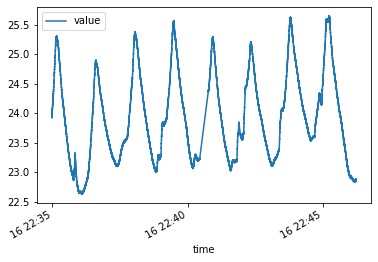

In [8]:
temp_413 = room_413[room_413.sensor == 'temperature']
temp_413.plot()
plt.show()

In [9]:
fig = go.Figure([go.Scatter(x=temp_413.index, y=temp_413.value)])
fig.show()

Output hidden; open in https://colab.research.google.com to view.

> function to retrieve sensor data for a specific room and reformat the dataframe for plotting

In [10]:
room = '413'
room_df = df[df.room == room].drop(columns='room')
print(room_df.shape)
print(room_df.index.nunique())
display(room_df.head())

(595678, 2)
321118


,value,sensor
time,,
1970-01-16 22:34:59.107,45.34,humidity
1970-01-16 22:34:59.108,45.34,humidity
1970-01-16 22:34:59.126,45.34,humidity
1970-01-16 22:34:59.131,45.31,humidity
1970-01-16 22:34:59.136,45.34,humidity


In [11]:
# function to manipulate room df into sensor df
def room_sensor(sensor_type):
    # separate the time series for each sensor in the room
    sensor_df = room_df[room_df.sensor == sensor_type].drop(columns="sensor")
    
    sensor_df.columns = [sensor_type]
    
    # create var for value change at each reading
#     sensor_df["diff"] = 
    
    # room_co2.head()
    return sensor_df

In [12]:
def df_sensors(room):
    room_co2 = room_sensor('co2')
    room_humidity = room_sensor('humidity')
    room_light = room_sensor('light')
    room_motion = room_sensor('pir')
    room_temp = room_sensor('temperature')
    return room_co2, room_humidity, room_light, room_motion, room_temp

room_co2, room_humidity, room_light, room_motion, room_temp = df_sensors(room)

In [13]:
@interact(
    co2_sensor=True,
    humidity_sensor=True,
    light_sensor=True,
    motion_sensor=True,
    temp_sensor=True)

def plot_sensors(co2_sensor, humidity_sensor, light_sensor, motion_sensor, temp_sensor):
    fig = go.Figure()

    if co2_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_co2.index, 
            y=room_co2['co2'], 
            mode='lines', 
            name='co2'))

    if humidity_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_humidity.index, 
            y=room_humidity['humidity'], 
            mode='lines', 
            name='humidity'))

    if light_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_light.index,
            y=room_light['light'],
            mode='lines',
            name='light'))

    if motion_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_motion.index,
            y=room_motion['pir'],
            mode='lines',
            name='pir motion'))

    if temp_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_temp.index,
            y=room_temp['temperature'],
            mode='lines',
            name='temperature'))

    fig.show()

> The co2 and maybe the light time series are going to require smoothing 

---
# Resampling

In [14]:
def room_resample(room_df):
#     room_df.index = room_df.time
#     room_df.drop(columns="time", inplace=True)
    room_df = room_df.resample('1S').mean()
    return room_df

In [15]:
room_co2 = room_resample(room_co2)
room_motion = room_resample(room_motion)
room_light = room_resample(room_light)
room_temp = room_resample(room_temp)
room_humidity = room_resample(room_humidity)

---
# Data Smoothing

In [16]:
# # co2 smoothing
# n_co2 = 100
# room_co2['co2_ma'] = room_co2['co2'].rolling(window=n_co2).mean()

# # light smoothing
# n_light = 300
# room_light['light_ma'] = room_light['light'].rolling(window=n_light).mean()

# # motion smoothing
# n_motion = 100
# room_motion['motion_ma'] = room_motion['pir'].rolling(window=n_motion).mean()

@interact(
    co2_sensor=False,
    humidity_sensor=False,
    light_sensor=False,
    motion_sensor=False,
    temp_sensor=False)

def plot_sensors(co2_sensor, humidity_sensor, light_sensor, motion_sensor, temp_sensor):
    fig = go.Figure()

    if co2_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_co2.index, 
            y=room_co2['co2'], 
            mode='lines', 
            name='co2_moving_avg'))

    if humidity_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_humidity.index, 
            y=room_humidity['humidity'], 
            mode='lines', 
            name='humidity'))

    if light_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_light.index,
            y=room_light['light'],
            mode='lines',
            name='light'))

    if motion_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_motion.index,
            y=room_motion['pir'],
            mode='lines',
            name='pir motion'))

    if temp_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_temp.index,
            y=room_temp['temperature'],
            mode='lines',
            name='temperature'))

    fig.show()

interactive(children=(Checkbox(value=False, description='co2_sensor'), Checkbox(value=False, description='humi…

# Differencing

In [17]:
def room_diff(sensor_df):
    sensor_df = sensor_df.reset_index()
    sensor_df['diff'] = 0
    col_name = sensor_df.columns[1]
    for i in range(1, sensor_df.shape[0]):
        sensor_df.loc[i, "diff"] = sensor_df.loc[i, col_name] - sensor_df.loc[i-1, col_name]
    return sensor_df

In [18]:
room_co2 = room_diff(room_co2)
room_humidity = room_diff(room_humidity)
room_light = room_diff(room_light)
room_motion = room_diff(room_motion)
room_temp = room_diff(room_temp)

In [19]:
room_co2.head()

,time,co2,diff
0,1970-01-16 22:34:59,507.072626,0.000000
1,1970-01-16 22:35:00,529.895000,22.822374
2,1970-01-16 22:35:01,544.120000,14.225000
3,1970-01-16 22:35:02,531.675000,-12.445000
4,1970-01-16 22:35:03,533.135000,1.460000


In [20]:
room_co2.head(500)

,time,co2,diff
0,1970-01-16 22:34:59,507.072626,0.000000
1,1970-01-16 22:35:00,529.895000,22.822374
2,1970-01-16 22:35:01,544.120000,14.225000
3,1970-01-16 22:35:02,531.675000,-12.445000
4,1970-01-16 22:35:03,533.135000,1.460000
...,...,...,...
495,1970-01-16 22:43:14,464.895000,5.865370
496,1970-01-16 22:43:15,463.230000,-1.665000
497,1970-01-16 22:43:16,462.565000,-0.665000
498,1970-01-16 22:43:17,463.660000,1.095000


In [21]:
# # co2 smoothing
# n_co2 = 2
# room_co2['co2_dma'] = room_co2['diff'].rolling(window=n_co2).mean()

# # light smoothing
# n_light = 2
# room_light['light_dma'] = room_light['diff'].rolling(window=n_light).mean()

# # motion smoothing
# n_motion = 1
# room_motion['light_dma'] = room_motion['diff'].rolling(window=n_motion).mean()


@interact(
    co2_sensor=False,
    humidity_sensor=False,
    light_sensor=False,
    motion_sensor=False,
    temp_sensor=False)

def plot_sensors(co2_sensor, humidity_sensor, light_sensor, motion_sensor, temp_sensor):
    fig = go.Figure()

    if co2_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_co2.index, 
            y=room_co2['diff'], 
            mode='lines', 
            name='co2 change'))

    if humidity_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_humidity.index, 
            y=room_humidity['diff'], 
            mode='lines', 
            name='humidity change'))

    if light_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_light.index,
            y=room_light['diff'],
            mode='lines',
            name='light change'))

    if motion_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_motion.index,
            y=room_motion['diff'],
            mode='lines',
            name='motion change'))

    if temp_sensor==True:
        fig.add_trace(go.Scatter(
            x=room_temp.index,
            y=room_temp['diff'],
            mode='lines',
            name='temperature change'))

    fig.show()

interactive(children=(Checkbox(value=False, description='co2_sensor'), Checkbox(value=False, description='humi…

# Machine Learning models

In [22]:
room_temp.head()

,time,temperature,diff
0,1970-01-16 22:34:59,23.978531,0.000000
1,1970-01-16 22:35:00,24.082900,0.104369
2,1970-01-16 22:35:01,24.204550,0.121650
3,1970-01-16 22:35:02,24.322550,0.118000
4,1970-01-16 22:35:03,24.465950,0.143400


In [23]:
room_co2.index = room_co2.time
room_co2.drop(columns="time", inplace=True)

room_humidity.index = room_humidity.time
room_humidity.drop(columns="time", inplace=True)

room_light.index = room_light.time
room_light.drop(columns="time", inplace=True)

room_motion.index = room_motion.time
room_motion.drop(columns="time", inplace=True)

room_temp.index = room_temp.time
room_temp.drop(columns="time", inplace=True)


In [24]:
room_humidity.head()

,humidity,diff
time,,
1970-01-16 22:34:59,45.306384,0.000000
1970-01-16 22:35:00,45.207200,-0.099184
1970-01-16 22:35:01,45.063900,-0.143300
1970-01-16 22:35:02,44.836350,-0.227550
1970-01-16 22:35:03,44.653850,-0.182500


In [25]:
X = room_co2.join(room_humidity.humidity)
X.head()

,co2,diff,humidity
time,,,
1970-01-16 22:34:59,507.072626,0.000000,45.306384
1970-01-16 22:35:00,529.895000,22.822374,45.207200
1970-01-16 22:35:01,544.120000,14.225000,45.063900
1970-01-16 22:35:02,531.675000,-12.445000,44.836350
1970-01-16 22:35:03,533.135000,1.460000,44.653850


In [26]:
X.drop(columns=["diff"], inplace=True)
X.head()

,co2,humidity
time,,
1970-01-16 22:34:59,507.072626,45.306384
1970-01-16 22:35:00,529.895000,45.207200
1970-01-16 22:35:01,544.120000,45.063900
1970-01-16 22:35:02,531.675000,44.836350
1970-01-16 22:35:03,533.135000,44.653850


In [27]:
X = X.join(room_light)

In [28]:
X.drop(columns=["diff"], inplace=True)
X.head()

,co2,humidity,light
time,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107
1970-01-16 22:35:00,529.895000,45.207200,91.300000
1970-01-16 22:35:01,544.120000,45.063900,91.440000
1970-01-16 22:35:02,531.675000,44.836350,96.550000
1970-01-16 22:35:03,533.135000,44.653850,108.185000


In [29]:
X.head()

,co2,humidity,light
time,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107
1970-01-16 22:35:00,529.895000,45.207200,91.300000
1970-01-16 22:35:01,544.120000,45.063900,91.440000
1970-01-16 22:35:02,531.675000,44.836350,96.550000
1970-01-16 22:35:03,533.135000,44.653850,108.185000


In [30]:
room_motion.head()

,pir,diff
time,,
1970-01-16 22:34:59,0.0,0.0
1970-01-16 22:35:00,0.0,0.0
1970-01-16 22:35:01,0.0,0.0
1970-01-16 22:35:02,0.0,0.0
1970-01-16 22:35:03,0.0,0.0


In [31]:
#room_motion.drop(columns="light", inplace=True)

In [32]:
X = X.join(room_motion)

In [33]:
X.drop(columns=["diff"], inplace=True)
X.head()

,co2,humidity,light,pir
time,,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107,0.0
1970-01-16 22:35:00,529.895000,45.207200,91.300000,0.0
1970-01-16 22:35:01,544.120000,45.063900,91.440000,0.0
1970-01-16 22:35:02,531.675000,44.836350,96.550000,0.0
1970-01-16 22:35:03,533.135000,44.653850,108.185000,0.0


In [34]:
#room_temp.set_index('time', inplace=True)

In [35]:
room_temp.head()

,temperature,diff
time,,
1970-01-16 22:34:59,23.978531,0.000000
1970-01-16 22:35:00,24.082900,0.104369
1970-01-16 22:35:01,24.204550,0.121650
1970-01-16 22:35:02,24.322550,0.118000
1970-01-16 22:35:03,24.465950,0.143400


In [36]:
X = X.join(room_temp.drop(columns=['diff']))
X.head()

,co2,humidity,light,pir,temperature
time,,,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107,0.0,23.978531
1970-01-16 22:35:00,529.895000,45.207200,91.300000,0.0,24.082900
1970-01-16 22:35:01,544.120000,45.063900,91.440000,0.0,24.204550
1970-01-16 22:35:02,531.675000,44.836350,96.550000,0.0,24.322550
1970-01-16 22:35:03,533.135000,44.653850,108.185000,0.0,24.465950


In [37]:
#X.drop(columns="diff", inplace=True)
X.head()

,co2,humidity,light,pir,temperature
time,,,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107,0.0,23.978531
1970-01-16 22:35:00,529.895000,45.207200,91.300000,0.0,24.082900
1970-01-16 22:35:01,544.120000,45.063900,91.440000,0.0,24.204550
1970-01-16 22:35:02,531.675000,44.836350,96.550000,0.0,24.322550
1970-01-16 22:35:03,533.135000,44.653850,108.185000,0.0,24.465950


# Regression

In [38]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [39]:
X.dropna(inplace=True)

In [40]:
X.size

3285

In [41]:
x = X.drop(columns="co2")
y = X.co2

> with normal values

In [42]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.5)

In [43]:
x_train.head()

,humidity,light,pir,temperature
time,,,,
1970-01-16 22:43:59,49.21010,3.860,0.0,24.87420
1970-01-16 22:42:57,52.26430,3.825,0.0,23.35445
1970-01-16 22:37:26,54.41175,74.220,0.0,23.13075
1970-01-16 22:35:35,46.04880,3.820,0.0,23.38165
1970-01-16 22:37:34,53.21950,97.705,0.0,23.41595


In [44]:
model = LinearRegression()
model.fit(x_train, y_train)
predictions = model.predict(x_test)

In [45]:
X.loc[x_test.index, "co2"]

time
1970-01-16 22:43:38    578.690000
1970-01-16 22:41:22    445.620000
1970-01-16 22:42:29    456.430000
1970-01-16 22:39:01    544.145000
1970-01-16 22:35:09    482.610000
                          ...    
1970-01-16 22:39:00    462.960000
1970-01-16 22:38:53    454.673367
1970-01-16 22:45:51    459.270000
1970-01-16 22:40:20    464.844221
1970-01-16 22:41:04    452.755000
Name: co2, Length: 329, dtype: float64

In [46]:
print('R-squared: ', r2_score(y_test, predictions))
print('Mean Absolute Error: ', mean_absolute_error(y_test, predictions))
print("Root mean squared error: ", np.sqrt(mean_squared_error(y_test, predictions)))

R-squared:  0.38040791257083717
Mean Absolute Error:  28.529059569009085
Root mean squared error:  45.39526339582282


In [47]:
x_test

,humidity,light,pir,temperature
time,,,,
1970-01-16 22:43:38,50.002550,92.430000,0.000000,24.551600
1970-01-16 22:41:22,50.234150,3.730000,0.000000,23.486650
1970-01-16 22:42:29,50.088350,3.790000,0.000000,24.573650
1970-01-16 22:39:01,49.099250,113.900000,20.618321,23.403600
1970-01-16 22:35:09,42.511450,155.600000,0.000000,25.291700
...,...,...,...,...
1970-01-16 22:39:00,48.859600,88.250000,2.825243,23.276900
1970-01-16 22:38:53,49.568250,61.405000,0.000000,23.193550
1970-01-16 22:45:51,49.934070,3.683417,0.000000,23.242261


In [48]:
X["predictions"] = model.predict(x)

In [49]:
X

,co2,humidity,light,pir,temperature,predictions
time,,,,,,
1970-01-16 22:34:59,507.072626,45.306384,97.853107,0.0,23.978531,485.889716
1970-01-16 22:35:00,529.895000,45.207200,91.300000,0.0,24.082900,485.744062
1970-01-16 22:35:01,544.120000,45.063900,91.440000,0.0,24.204550,488.360381
1970-01-16 22:35:02,531.675000,44.836350,96.550000,0.0,24.322550,492.462141
1970-01-16 22:35:03,533.135000,44.653850,108.185000,0.0,24.465950,499.738521
...,...,...,...,...,...,...
1970-01-16 22:46:09,443.819095,51.011457,92.748744,0.0,22.850251,473.672612
1970-01-16 22:46:10,442.780000,51.216281,96.190955,0.0,22.853166,475.644988
1970-01-16 22:46:11,445.345000,51.374020,99.231156,0.0,22.853618,477.263378


In [50]:
@interact(
    co2_sensor=True,
    co2_predictions = True)

def plot_sensors(co2_sensor, co2_predictions):
    fig = go.Figure()

    if co2_sensor==True:
        fig.add_trace(go.Scatter(
            x=X.index, 
            y=X.co2, 
            mode='lines', 
            name='co2'))

    if co2_predictions==True:
        fig.add_trace(go.Scatter(
            x=X.index, 
            y=X.predictions, 
            mode='lines', 
            name='prediction'))

    fig.show()

interactive(children=(Checkbox(value=True, description='co2_sensor'), Checkbox(value=True, description='co2_pr…